## Installation

1. If you haven't already installed Python3, get it from [Python.org](https://www.python.org/downloads/)
1. If you haven't already installed Jupyter Notebook, run `python3 -m pip install jupyter`
1. In Terminal, cd to the folder in which you downloaded this file and run `jupyter notebook`. This should open up a page in your web browser that shows all of the files in the current directory, so that you can open this file. You will need to leave this Terminal window up and running and use a different one for the rest of the instructions.
1. If you didn't install keras previously, install it now
    1. Install the tensorflow machine learning library by typing the following into Terminal:
    `pip3 install --upgrade tensorflow`
    1. Install the keras machine learning library by typing the following into Terminal:
    `pip3 install keras`


## Documentation/Sources
* [https://machinelearningmastery.com/sequence-classification-lstm-recurrent-neural-networks-python-keras/](https://machinelearningmastery.com/sequence-classification-lstm-recurrent-neural-networks-python-keras/) for information on sequence classification with keras
* [https://keras.io/](https://keras.io/) Keras API documentation
* [Keras recurrent tutorial](https://github.com/Vict0rSch/deep_learning/tree/master/keras/recurrent)

## The IMDB Dataset
The [IMDB dataset](https://keras.io/datasets/#imdb-movie-reviews-sentiment-classification) consists of movie reviews (x_train) that have been marked as positive or negative (y_train). See the [Word Vectors Tutorial](https://github.com/jennselby/MachineLearningTutorials/blob/master/WordVectors.ipynb) for more details on the IMDB dataset.

In [1]:
from keras.datasets import imdb
from keras.preprocessing import sequence

Using TensorFlow backend.
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


In [2]:
(imdb_x_train, imdb_y_train), (imdb_x_test, imdb_y_test) = imdb.load_data()

For a standard keras model, every input has to be the same length, so we need to set some length after which we will cutoff the rest of the review. (We will also need to pad the shorter reviews with zeros to make them the same length).

In [3]:
cutoff = 500

In [4]:
imdb_x_train_padded = sequence.pad_sequences(imdb_x_train, maxlen=cutoff)
imdb_x_test_padded = sequence.pad_sequences(imdb_x_test, maxlen=cutoff)

## Classification

In [5]:
from keras.models import Sequential
from keras.layers import Embedding, LSTM, Dense

Define our model.

Unlike last time, when we used convolutional layers, we're going to use an LSTM, a special type of recurrent network.

Using recurrent networks means that rather than seeing these reviews as one input happening all at one, with the convolutional layers taking into account which words are next to each other, we are going to see them as a sequence of inputs, with one word occurring at each timestep.

This makes more sense for things like natural language processing, when the dataset is more of a sequence, than blocks to be analyzed.

In [6]:
imdb_lstm_model = Sequential()
imdb_lstm_model.add(Embedding(input_dim=len(imdb.get_word_index())+3, output_dim=100, input_length=cutoff))
# return_sequences tells the LSTM to output the full sequence, for use by the next LSTM layer. The final
# LSTM layer should return only the output sequence, for use in the Dense output layer
imdb_lstm_model.add(LSTM(units=32, return_sequences=True))
imdb_lstm_model.add(LSTM(units=32, return_sequences=True)) 
imdb_lstm_model.add(LSTM(units=32)) 
#if you want to feed into another LSTM return_sequences needs 'true'
#dense layer takes in the output from prev LSTM layer and multiplies the 32 units by the 'learned' weights 
#puts that number through a sigmoid function which will then return a 0 or 1
#imdb_lstm_model.add(LSTM(units=1))
imdb_lstm_model.add(Dense(units=1, activation='sigmoid')) # because at the end, we want one yes/no answer
imdb_lstm_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['binary_accuracy'])

Train the model. __This takes awhile. You might not want to re-run it.__

Note:
-Normally, people don't set the weights by hand, we are just doing it here to see how the weights interact with the inputed data

-Keras initializes weights for you, but you have to tell TensorFlow

-When fitting the model, you input the training input and training output, and the model back-propogates to find the best weights given the known training output


In [7]:
imdb_lstm_model.fit(imdb_x_train_padded, imdb_y_train, epochs=1, batch_size=64)
#epoch means number of time you see the dataset, for larger problems, use larger epochs 

Epoch 1/1
25000/25000 [==============================] - 404s 16ms/step - loss: 0.4144 - binary_accuracy: 0.8082


Assess the model. __This takes awhile. You might not want to re-run it.__

In [8]:
imdb_lstm_scores = imdb_lstm_model.evaluate(imdb_x_test_padded, imdb_y_test)
print('loss: {} accuracy: {}'.format(*imdb_lstm_scores))

25000/25000 [==============================] - 110s 4ms/step
loss: 0.3577245139789581 accuracy: 0.86388


# Exercise 1

Experiment with different model configurations from the one above. Try other recurrent layers, different numbers of layers, change some of the defaults. See [Keras Recurrent Layers](https://keras.io/layers/recurrent/)

##### This is the result before any changes:

Epoch 1/1
25000/25000 [==============================] - 379s 15ms/step - loss: 0.3898 - binary_accuracy: 0.8198
Out[8]:
<keras.callbacks.History at 0x112f3f518>

25000/25000 [==============================] - 107s 4ms/step
loss: 0.3007625757217407 accuracy: 0.87688

##### This is the result when changing the final Dense layer into an LSTM layer with 1 unit 
Epoch 1/1
25000/25000 [==============================] - 415s 17ms/step - loss: 0.5428 - binary_accuracy: 0.7208
Out[9]:
<keras.callbacks.History at 0x1231e6080>
25000/25000 [==============================] - 118s 5ms/step
loss: 0.3751904130935669 accuracy: 0.847


#### This is the result when adding another LSTM layer with the same final Dense layer:
Epoch 1/1
25000/25000 [==============================] - 429s 17ms/step - loss: 0.3931 - binary_accuracy: 0.8148

25000/25000 [==============================] - 116s 5ms/step - loss: 0.3479012288856506 accuracy: 0.85408

Based on this small dataset, it seems that adding new LSTM layers does not necessarily improve accuracy, and final Dense layer seems to give the most accuracy

Reasons more layers don't always help: 
-overfitting
-when adding more layers, might need more epochs

## Exploring Simple Recurrent Layers

Before we dive into something as complicated as LSTMs, Let's take a deeper look at simple recurrent layer weights.

In [9]:
import numpy
from keras.layers import SimpleRNN

### Visualization:
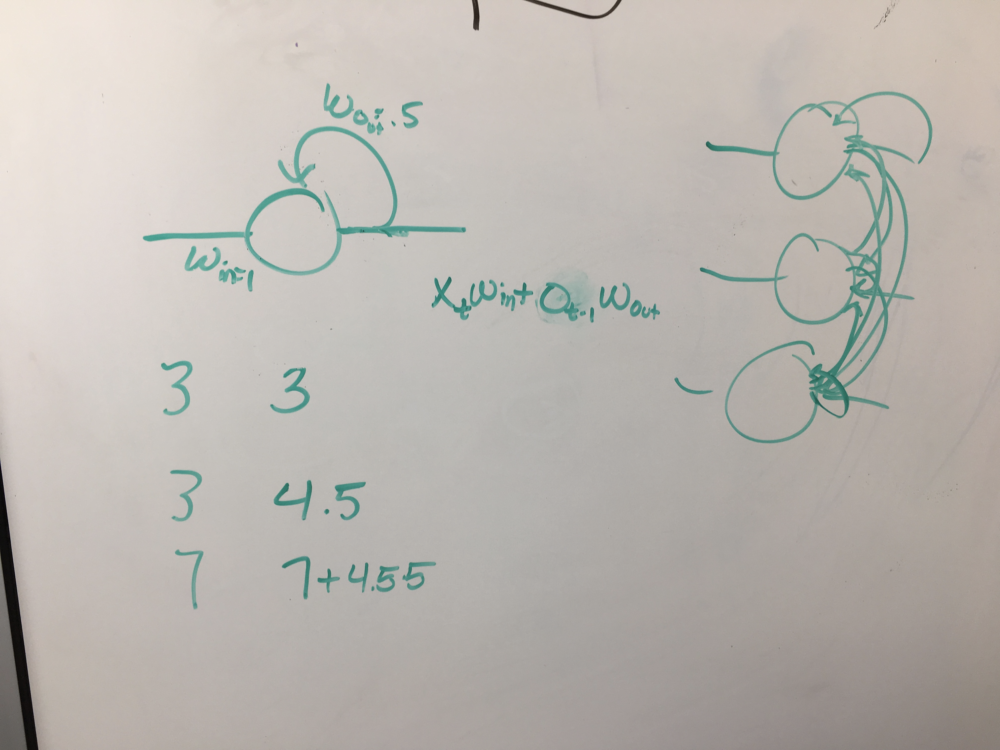

The neurons in the recurrent layer pass their output to the next layer, but also back to themselves. The input shape says that we'll be passing in one-dimensional inputs of unspecified length (the None is what makes it unspecified).

In [10]:
one_unit_SRNN = Sequential()
#usually activation function is not linear, but when it is, the output is just taken directly instead of put through a function
one_unit_SRNN.add(SimpleRNN(units=1, input_shape=(None, 1), activation='linear', use_bias=False))

In [11]:
one_unit_SRNN_weights = one_unit_SRNN.get_weights()
one_unit_SRNN_weights
#this will return 2 weights (in an array) - corresponds to input and output weights, respectively

[array([[0.913736]], dtype=float32), array([[1.]], dtype=float32)]

In [12]:
#setting input and output weights to be 1 
one_unit_SRNN_weights[0][0][0] = 1
one_unit_SRNN_weights[1][0][0] = .5
one_unit_SRNN.set_weights(one_unit_SRNN_weights)
one_unit_SRNN.get_weights()
one_unit_SRNN_weights

[array([[1.]], dtype=float32), array([[0.5]], dtype=float32)]

This passes in a single sample that has three time steps.

In [13]:
one_unit_SRNN.predict(numpy.array([ [[3], [3], [7]] ]))

array([[9.25]], dtype=float32)

# Exercise 2a
Figure out what the two weights in the one_unit_SRNN model control. Be sure to test your hypothesis thoroughly. Use different weights and different inputs.

Let's try a slightly larger simple recurrent model.

In [14]:
two_unit_SRNN = Sequential()
two_unit_SRNN.add(SimpleRNN(units=2, input_shape=(None, 1), activation='linear', use_bias=False))

In [15]:
two_unit_SRNN_weights = two_unit_SRNN.get_weights()
two_unit_SRNN_weights

[array([[ 0.57423186, -1.0011326 ]], dtype=float32),
 array([[-0.5287887,  0.8487535],
        [ 0.8487535,  0.5287887]], dtype=float32)]

### Visualization of the weights:
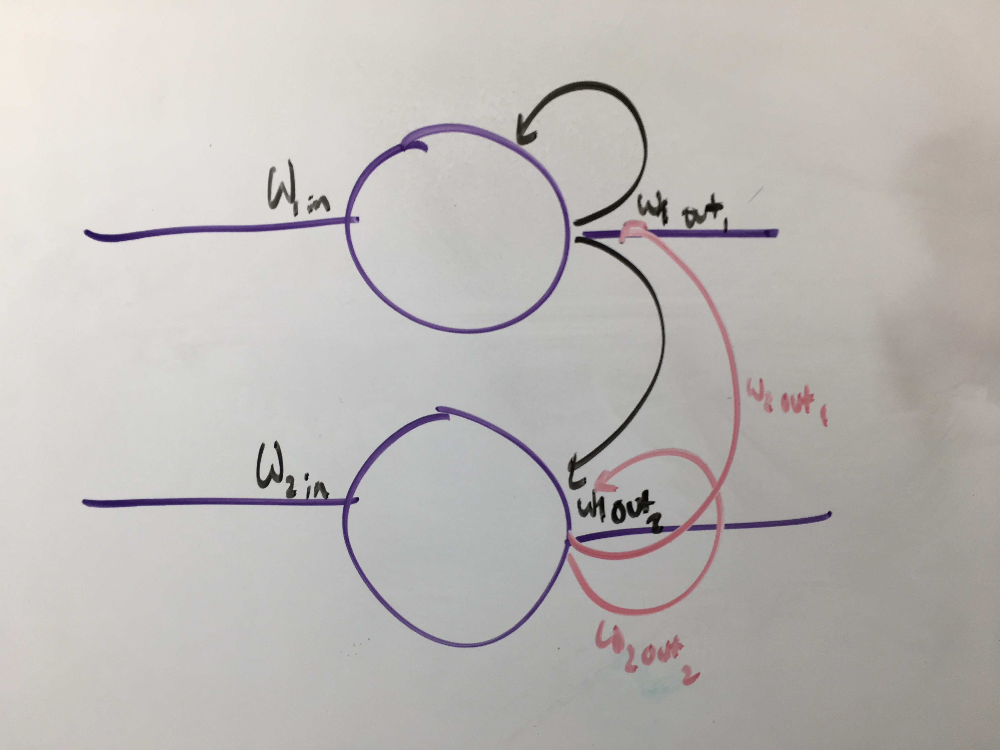

In [16]:
two_unit_SRNN_weights[0][0][0] = 1 #W1In1
two_unit_SRNN_weights[0][0][1] = 1 #W2In1
two_unit_SRNN_weights[1][0][0] = 0  #W1Out1
two_unit_SRNN_weights[1][0][1] = 0     #W2Out1 
two_unit_SRNN_weights[1][1][0] = 0     #W2Out2   
two_unit_SRNN_weights[1][1][1] = 1  #W1Out2
two_unit_SRNN.set_weights(two_unit_SRNN_weights)
two_unit_SRNN.get_weights()

[array([[1., 1.]], dtype=float32), array([[0., 0.],
        [0., 1.]], dtype=float32)]

This passes in a single sample with four time steps.

In [17]:
two_unit_SRNN.predict(numpy.array([ [[3], [3], [7], [5]] ]))

array([[ 5., 18.]], dtype=float32)

## Exploring LSTMs


In [18]:
one_unit_LSTM = Sequential()
one_unit_LSTM.add(LSTM(units=1, input_shape=(None, 1),
                       activation='linear', recurrent_activation='linear',
                       use_bias=False, unit_forget_bias=False,
                       kernel_initializer='zeros',
                       recurrent_initializer='zeros',
                       return_sequences=True))

In [19]:
one_unit_LSTM_weights = one_unit_LSTM.get_weights()
one_unit_LSTM_weights 
#there are 4 weights per input / output because there is a forget gate, input gate, output gate, and cell 

[array([[0., 0., 0., 0.]], dtype=float32),
 array([[0., 0., 0., 0.]], dtype=float32)]

#### This is a one unit, one layer LSTM at 3 time steps
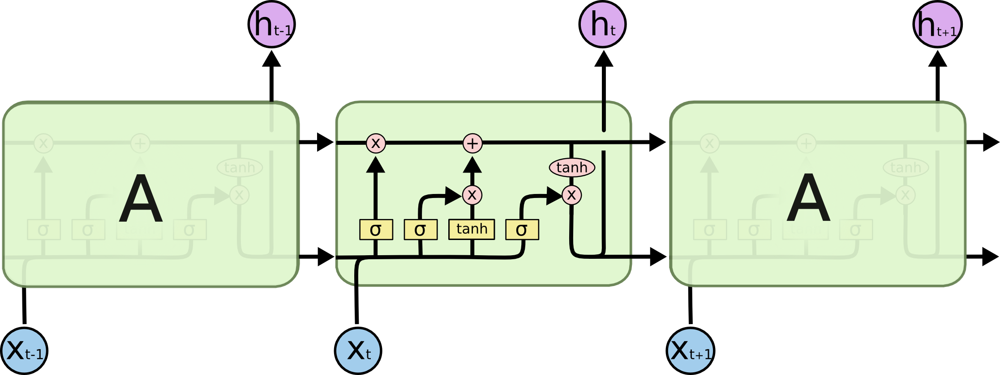


_Note_: The three exercises in this tutorial can be done in any order. Decide which interests you the most, and start with that one. You don't have to do all of them.

In [20]:
one_unit_LSTM_weights[0][0][0] = 1
one_unit_LSTM_weights[0][0][1] = 0
one_unit_LSTM_weights[0][0][2] = 1
one_unit_LSTM_weights[0][0][3] = 1
one_unit_LSTM_weights[1][0][0] = 0
one_unit_LSTM_weights[1][0][1] = 0
one_unit_LSTM_weights[1][0][2] = 0
one_unit_LSTM_weights[1][0][3] = 0
one_unit_LSTM.set_weights(one_unit_LSTM_weights)
one_unit_LSTM.get_weights()

[array([[1., 0., 1., 1.]], dtype=float32),
 array([[0., 0., 0., 0.]], dtype=float32)]

In [21]:
one_unit_LSTM.predict(numpy.array([ [[0], [1], [2], [4]] ]))

array([[[ 0.],
        [ 1.],
        [ 8.],
        [64.]]], dtype=float32)

# Exercise 2c
Conceptually, the [LSTM](http://colah.github.io/posts/2015-08-Understanding-LSTMs/) has several _gates_:

* __Forget gate__: these weights allow some long-term memories to be forgotten.
* __Input gate__: these weights decide what new information will be added to the context cell.
* __Output gate__: these weights decide what pieces of the new information and updated context will be passed on to the output.

It also has a __cell__ that can hold onto information from the current input (as well as things it has remembered from previous inputs), so that it can be used in later outputs.

Identify which weights in the one_unit_LSTM model are connected with the context and which are associated with the three gates?

_Note_: The output from the predict call is what the linked explanation calls $h_{t}$.

# Exercise 3

Take the model from exercise 1 (imdb_lstm_model) and modify it to classify the [Reuters data](https://keras.io/datasets/#reuters-newswire-topics-classification).

Think about what you are trying to predict in this case, and how you will have to change your model to deal with this.

In [22]:
from keras.datasets import reuters

In [23]:
(reuters_x_train, reuters_y_train), (reuters_x_test, reuters_y_test) = reuters.load_data()